In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import anndata as ad
import csv
import gpzoo.pri_experiment_utilities as putil
import matplotlib.pyplot as plt
import numpy as np
import random
import scanpy as sc
import scipy.sparse as sparse
import squidpy as sq
import tensorflow as tf
import time
import torch
import torch.nn.utils as nn_utils

from anndata import AnnData
from contextlib import suppress
from copy import deepcopy
from gpzoo.gp import SVGP
from gpzoo.kernels import NSF_RBF
from gpzoo.likelihoods import NSF2
from gpzoo.utilities import (add_jitter, anndata_to_train_val, deviancePoisson, dims_autocorr, regularized_nmf, rescale_spatial_coords, scanpy_sizefactors)
from os import path
from scanpy import read_h5ad
from sklearn.cluster import KMeans
from sklearn.decomposition import NMF
from sklearn.model_selection import ParameterGrid, KFold, train_test_split
from squidpy.gr import spatial_autocorr, spatial_neighbors
from tensorflow import constant
from tensorflow.data import Dataset
from torch import distributions, nn, optim
from tqdm import tqdm

2024-10-02 16:59:44.152275: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-02 16:59:44.172648: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:479] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-02 16:59:44.202890: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:10575] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-02 16:59:44.202936: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1442] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-02 16:59:44.220525: I tensorflow/core/platform/cpu_feature_gua

In [3]:
print("CUDA available: ", torch.cuda.is_available())
print("Number of GPUs: ", torch.cuda.device_count())
print("Current GPU: ", torch.cuda.current_device())
print("GPU Name: ", torch.cuda.get_device_name(torch.cuda.current_device()))

CUDA available:  True
Number of GPUs:  2
Current GPU:  0
GPU Name:  NVIDIA A30


In [4]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=0)

In [5]:
random.seed(256)
root_path = '/engelhardt/home/pshrestha/vnngp/'
save_path = path.join(root_path, 'results/visium/nsfh')
ROOT_PATH = '/engelhardt/home/pshrestha/vnngp/'
RPATH = path.join(ROOT_PATH, "results/")
SPATH = path.join(RPATH, "visium/")
FPATH = path.join(SPATH, "plots/")

In [6]:
save_path

'/engelhardt/home/pshrestha/vnngp/results/visium/nsfh'

In [7]:
X, Y = putil.load_visium()
Y = Y.T

#### writing notes
##### able to increase K up to 500  with 2000 inducing points before CUDA out of memory

## Make model

In [34]:
kwargs = {'L': 5, 
          'M': len(X), # use total number of inducing points
          'sigma': 0.7, 
          'lengthscale': 0.008, 
          'jtr': 1e-2, 
          'batch_size': 128,
          'lr': 0.0001,
          'rs': 256,
          'lkzz_build': 1,
          'model': 'SVGP',
          'L1_jitter': 1e-1, 
         }

In [21]:
nmf_save_path = path.join(root_path, 'results/visium/nmf/')
factors_path = path.join(nmf_save_path, f"nmf_factors_iter=1000_rs=256_L={kwargs['L']}.npy")
loadings_path = path.join(nmf_save_path, f"nmf_loadings_iter=1000_rs=256_L={kwargs['L']}.npy")
factors = np.load(factors_path)
loadings = np.load(loadings_path)

In [22]:
moran_idx, moranI = putil.dims_autocorr(factors, np.array(X))
factors = factors[:, moran_idx]
loadings = loadings[:, moran_idx]

In [23]:
model = putil.build_model_hybrid(np.array(X), np.array(Y).T, loadings=loadings, factors=factors, kwargs=kwargs)
losses, means, scales, final_time = [], [], [], 0

In [24]:
model.sf.prior.Z.requires_grad=False
model.cf.prior.scale_pf = 1e-1
model.V.requires_grad=False

In [25]:
model.sf.prior.jitter = kwargs['jtr']

## 1. Train Spatial and Nonspatial Variances

In [26]:
model.cf.prior.scale.requires_grad = True
model.sf.prior.Lu.requires_grad=True

model.sf.prior.kernel.lengthscale.requires_grad = False
model.sf.prior.kernel.sigma.requires_grad = False
model.sf.prior.mu.requires_grad=False
model.sf.W.requires_grad=False
model.cf.W.requires_grad=False
model.cf.prior.mean.requires_grad=False

In [27]:
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=kwargs['lr'])
model.to(device)
X_torch = torch.tensor(X).type(torch.float).to(device)
Y_torch = torch.tensor(Y).type(torch.float).to(device)

In [33]:
warnings.filterwarnings('ignore')
model.to(device)
X_torch = torch.tensor(X).type(torch.float).to(device)
Y_torch = torch.tensor(Y).type(torch.float).to(device)
more_losses, more_means, more_scales, idxs = putil.train_hybrid_batched(model, optimizer, X_torch, Y_torch.T, device, 
                                                                         steps=100*360, E=3, batch_size=kwargs['batch_size'],
                                                                         kwargs=kwargs)

  0%|          | 0/36000 [00:00<?, ?it/s]

self.scale:  Parameter containing:
tensor([[ 0.4275,  0.6104,  0.2789,  ..., -0.3092,  0.1064,  0.6007],
        [ 0.1738,  0.2380, -0.3771,  ...,  0.1171,  0.3695, -0.1924],
        [-0.2201, -0.0845, -0.0469,  ...,  0.6633,  0.1394, -0.1816],
        [ 0.0071,  0.0620,  0.2359,  ..., -0.1871,  0.2925,  0.0549]],
       device='cuda:0', requires_grad=True)
idx:  tensor([1479, 2062, 2454, 1667, 2196, 1511, 1999, 1949, 2144, 2597, 1644,  166,
         135, 2320, 1500, 1004, 1712, 2385, 1548, 1138, 1367, 2126,   51,  903,
        2181, 1329, 2285,  907, 2257, 1424, 1864, 2091, 2297,  748, 2586, 1174,
         568,  700,  347, 2291, 2321,   40, 1541, 1882, 2606,  915, 1962,  694,
         356, 2222, 1941, 2518, 1532, 1726,  144,  445,  591, 2051,  130,  263,
         220,  877, 1590, 1648,  916,  732, 1477,  741,  821, 2241, 1817, 2576,
         282, 2354,  511,  150, 2177, 2200, 1492,   96, 1021,  671, 2382, 2180,
        2629, 1008, 1520,   55, 1651, 1198, 1392,  944, 2422, 1211,  479, 

KeyboardInterrupt: 

In [29]:
losses += more_losses

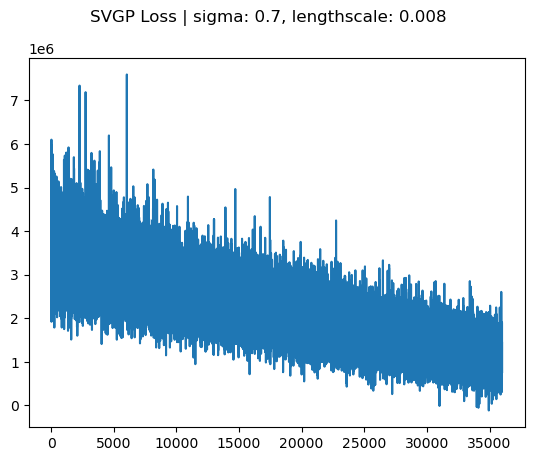

In [30]:
fig1, ax1 = plt.subplots()
ax1.plot(more_losses)
fig1.suptitle(f"{kwargs['model']} Loss | sigma: {kwargs['sigma']}, lengthscale: {kwargs['lengthscale']}")
plt.show()

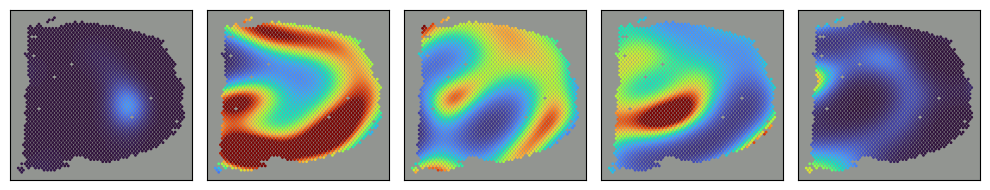

In [31]:
model.cpu()
X_torch = torch.tensor(X).type(torch.float).to('cpu')
qF, _, _ = model.sf.prior(X_torch, kwargs=kwargs)
mean = torch.exp(qF.mean).detach().numpy()

if kwargs['L'] == 5:
    fig2 = putil.plot_factors_five(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
else:
    fig2 = putil.plot_factors(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
plt.show()

In [38]:
## train mean and variance (spatial) until convergence  (6 hrs)

In [39]:
model.sf.prior.Lu.requires_grad=True
model.sf.prior.mu.requires_grad=True

model.cf.prior.mean.requires_grad=False
model.cf.prior.scale.requires_grad = False
model.sf.prior.kernel.lengthscale.requires_grad = False
model.sf.prior.kernel.sigma.requires_grad = False
model.sf.W.requires_grad=False
model.cf.W.requires_grad=False

In [40]:
with torch.no_grad():
    if device.type=='cuda':
        torch.cuda.empty_cache()

In [ ]:
model.to(device)
X_torch = torch.tensor(X).type(torch.float).to(device)
Y_torch = torch.tensor(Y).type(torch.float).to(device)
more_losses, more_means, more_scales, idxs = putil.train_hybrid_batched(model, optimizer, X_torch, Y_torch.T, device, 
                                                                         steps=100*360*2, E=3, batch_size=kwargs['batch_size'],
                                                                         kwargs=kwargs)

  0%|          | 0/72000 [00:00<?, ?it/s]

self.scale:  Parameter containing:
tensor([[ 0.4236,  0.6059,  0.2778,  ..., -0.3129,  0.1018,  0.5964],
        [ 0.1697,  0.2344, -0.3801,  ...,  0.1146,  0.3647, -0.1939],
        [-0.2246, -0.0887, -0.0492,  ...,  0.6617,  0.1350, -0.1852],
        [ 0.0032,  0.0570,  0.2306,  ..., -0.1907,  0.2901,  0.0502]],
       device='cuda:0')
idx:  tensor([1802,   16, 2275, 2429, 2166,  961, 1844, 1332, 2207,   66, 1989, 1053,
         159, 2483, 1731, 1716, 1310, 2191,  876, 1409,  702,  423, 1869, 1992,
        2614, 1524, 1093, 1301, 2593, 2402, 2033, 2164, 1196,  747,  615,   91,
        2323, 1670, 1339, 1680,  692,  743,  379, 1062, 2199, 2018, 1795,  983,
         713,  801, 1739, 1759, 1900,  387,  151, 1849,  966, 2469, 2161, 1987,
         595, 2568, 1810,  956,  247, 2432, 1493, 1930, 1449, 2266, 1803,   56,
        2174, 1644, 2269,  451,  421,  758, 2224,  400,  536,  686,  940,  738,
        1224,  427, 1192, 1077, 1181, 1199, 2453, 2670, 2043,  283, 2124, 1395,
         639, 

In [35]:
losses += more_losses

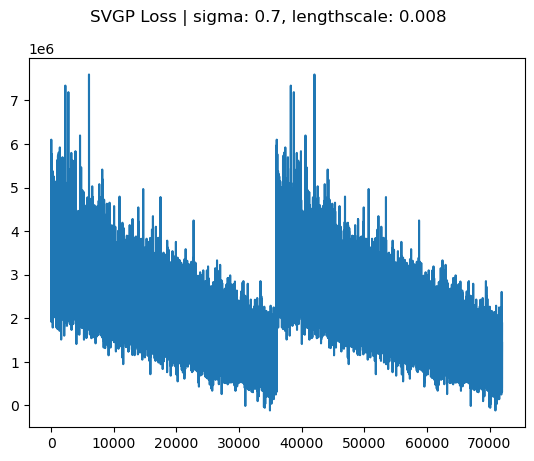

In [36]:
fig1, ax1 = plt.subplots()
ax1.plot(losses)
fig1.suptitle(f"{kwargs['model']} Loss | sigma: {kwargs['sigma']}, lengthscale: {kwargs['lengthscale']}")
plt.show()

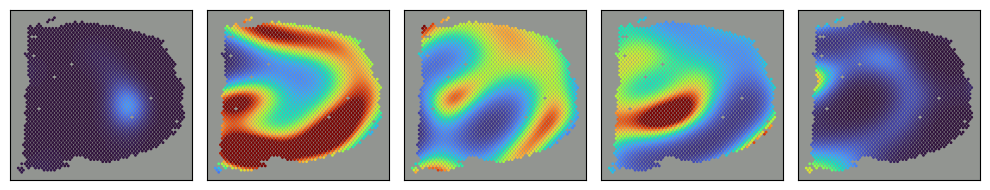

In [37]:
model.cpu()
X_torch = torch.tensor(X).type(torch.float).to('cpu')
qF, _, _ = model.sf.prior(X_torch, kwargs=kwargs)
mean = torch.exp(qF.mean).detach().numpy()

if kwargs['L'] == 5:
    fig2 = putil.plot_factors_five(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
else:
    fig2 = putil.plot_factors(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
plt.show()

In [46]:
with torch.no_grad():
    if device.type=='cuda':
        torch.cuda.empty_cache()

In [47]:
# 2. train mean and variance until convergence + non-spatial variance (3 hrs)
model.sf.prior.Lu.requires_grad=True
model.sf.prior.mu.requires_grad=True
model.cf.prior.scale.requires_grad = True

model.cf.prior.mean.requires_grad=False
model.cf.prior.scale.requires_grad = False
model.sf.prior.kernel.lengthscale.requires_grad = False
model.sf.prior.kernel.sigma.requires_grad = False
model.sf.W.requires_grad=False
model.cf.W.requires_grad=False

In [ ]:
model.to(device)
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=kwargs['lr'])
X_torch = torch.tensor(X).type(torch.float).to(device)
Y_torch = torch.tensor(Y).type(torch.float).to(device)
more_losses, more_means, more_scales, idxs = putil.train_hybrid_batched(model, optimizer, X_torch, Y_torch.T, device, 
                                                                         steps=100*360, E=3, batch_size=kwargs['batch_size'],
                                                                         kwargs=kwargs)

  0%|          | 0/36000 [00:00<?, ?it/s]

=
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be bett

In [50]:
losses += more_losses

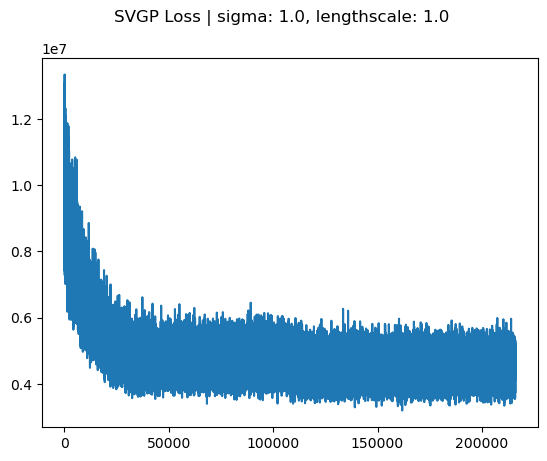

In [51]:
fig1, ax1 = plt.subplots()
ax1.plot(losses)
fig1.suptitle(f"{kwargs['model']} Loss | sigma: {kwargs['sigma']}, lengthscale: {kwargs['lengthscale']}")
plt.show()

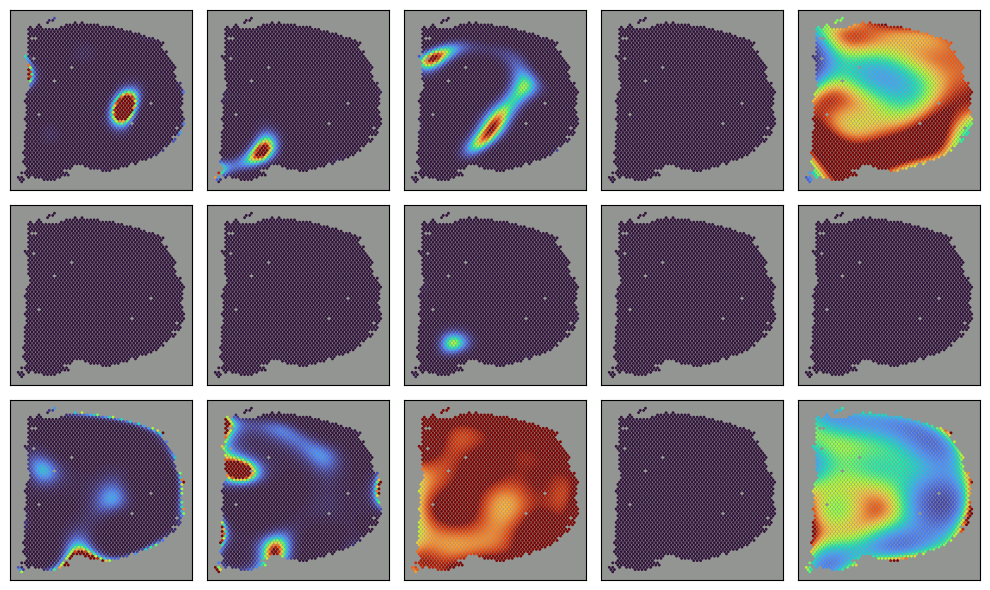

In [52]:
model.cpu()
X_torch = torch.tensor(X).type(torch.float).to('cpu')
qF, _, _ = model.sf.prior(X_torch, kwargs=kwargs)
mean = torch.exp(qF.mean).detach().numpy()

if kwargs['L'] == 5:
    fig2 = putil.plot_factors_five(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
else:
    fig2 = putil.plot_factors(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
plt.show()

In [55]:
# 3. train mean, variance and loadings spatial + non-spatial variance (6hrs)
model.sf.prior.Lu.requires_grad=True
model.sf.prior.mu.requires_grad=True
model.cf.prior.scale.requires_grad = True
model.sf.W.requires_grad=True

model.cf.prior.mean.requires_grad=False
model.cf.prior.scale.requires_grad = False
model.sf.prior.kernel.lengthscale.requires_grad = False
model.sf.prior.kernel.sigma.requires_grad = False
model.cf.W.requires_grad=False

In [56]:
model.to(device)
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001)
X_torch = torch.tensor(X).type(torch.float).to(device)
Y_torch = torch.tensor(Y).type(torch.float).to(device)
more_losses, more_means, more_scales, idxs = putil.train_hybrid_batched(model, optimizer, X_torch, Y_torch.T, device, 
                                                                         steps=10000, E=3, batch_size=kwargs['batch_size'],
                                                                         kwargs=kwargs)

  0%|          | 0/10000 [00:00<?, ?it/s]

   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better

In [57]:
losses += more_losses

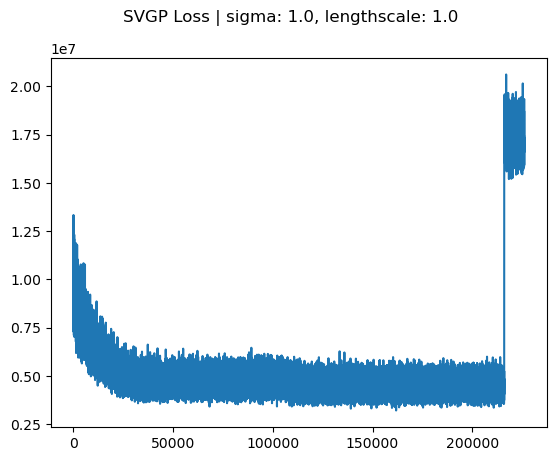

In [58]:
fig1, ax1 = plt.subplots()
ax1.plot(losses)
fig1.suptitle(f"{kwargs['model']} Loss | sigma: {kwargs['sigma']}, lengthscale: {kwargs['lengthscale']}")
plt.show()

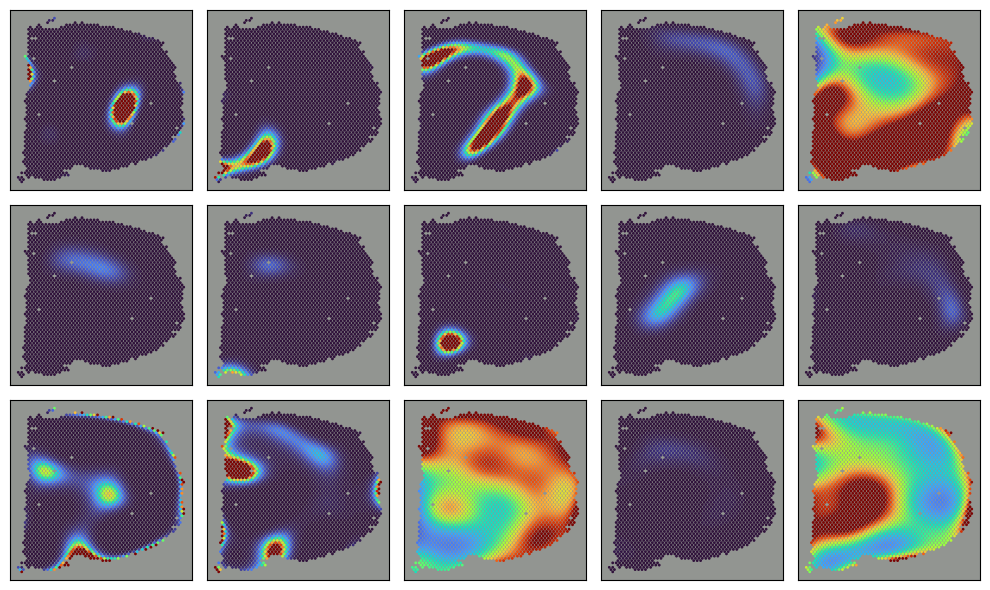

In [60]:
model.cpu()
X_torch = torch.tensor(X).type(torch.float).to('cpu')
qF, _, _ = model.sf.prior(X_torch, kwargs=kwargs)
mean = torch.exp(qF.mean).detach().numpy()

if kwargs['L'] == 5:
    fig2 = putil.plot_factors_five(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
else:
    fig2 = putil.plot_factors(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
plt.show()

In [ ]:
model.to(device)
optimizer = optim.Adam(filter(lambda p: p.requires_grad, model.parameters()), lr=0.0001)
X_torch = torch.tensor(X).type(torch.float).to(device)
Y_torch = torch.tensor(Y).type(torch.float).to(device)
more_losses, more_means, more_scales, idxs = putil.train_hybrid_batched(model, optimizer, X_torch, Y_torch.T, device, 
                                                                         steps=100*360*2, E=3, batch_size=kwargs['batch_size'],
                                                                         kwargs=kwargs)

  0%|          | 0/72000 [00:00<?, ?it/s]

   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better to use the
   Native/Hybrid classical routines if you want good performance.
   WARNING batched routines are designed for small sizes. It might be better

In [63]:
losses += more_losses

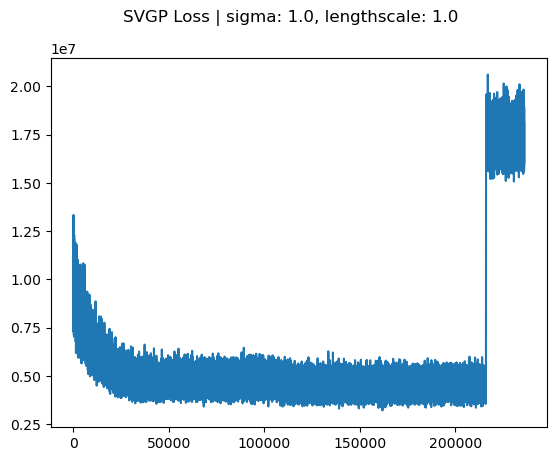

In [64]:
fig1, ax1 = plt.subplots()
ax1.plot(losses)
fig1.suptitle(f"{kwargs['model']} Loss | sigma: {kwargs['sigma']}, lengthscale: {kwargs['lengthscale']}")
plt.show()

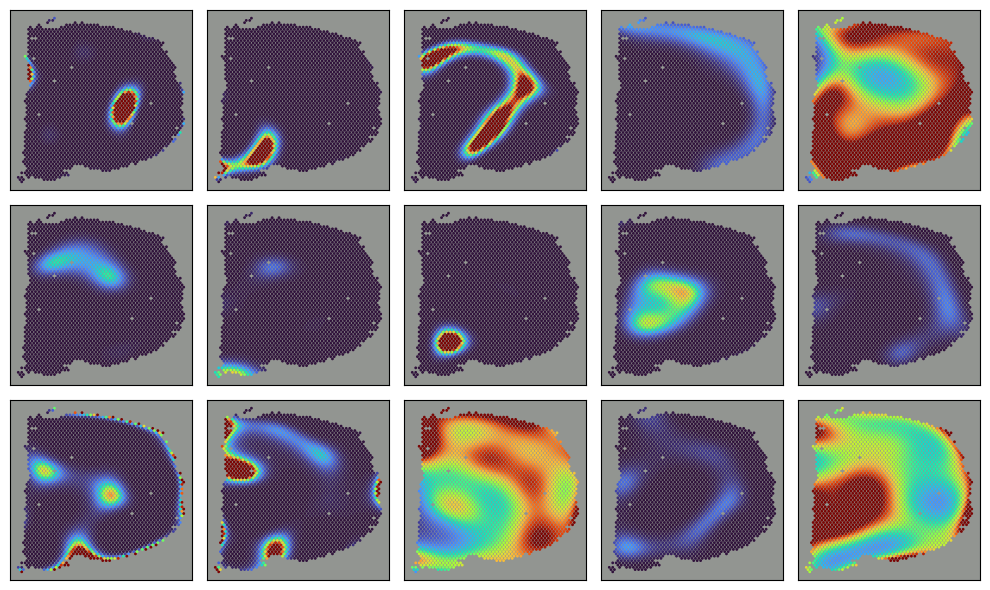

In [65]:
model.cpu()
X_torch = torch.tensor(X).type(torch.float).to('cpu')
qF, _, _ = model.sf.prior(X_torch, kwargs=kwargs)
mean = torch.exp(qF.mean).detach().numpy()

if kwargs['L'] == 5:
    fig2 = putil.plot_factors_five(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
else:
    fig2 = putil.plot_factors(mean, X_torch.cpu().detach().numpy(), moran_idx=None, size=2, s=1, alpha=1, ax=None)
plt.show()

## Looking at validation models

In [36]:
X_train, X_val, y_train, y_val = train_test_split(X, Y, test_size=0.05, random_state=256)

In [10]:
dicts = kwargs
dicts['M'] = len(X_train)

In [11]:
# Visualize Factors
import warnings
warnings.filterwarnings("ignore") 

nmf_save_path = path.join(SPATH, 'nmf')
factors_path = path.join(nmf_save_path, f"train_nmf_factors_iter=1000_rs=256_L={15}.npy")
loadings_path = path.join(nmf_save_path, f"train_nmf_loadings_iter=1000_rs=256_L={15}.npy")
factors = np.load(factors_path)
loadings = np.load(loadings_path)
NSFH = putil.build_model_hybrid(X_train, y_train.T, loadings=loadings, factors=factors, model_type='SVGP', kwargs=dicts)
putil.model_grads_hybrid(NSFH)
NSFH.sf.prior.jitter = dicts['jtr']


#print(loadings)
file_path = f"validation_experiments/SVGP_M=2553_L=15_lr=0.001_jtr=0.1_ls=1.0_sigma=1.0_bs=128_NMFinit_state_dict.pth"
dict_path = path.join(save_path, file_path)
NSFH.load_state_dict(torch.load(dict_path))
X = torch.tensor(X).type(torch.float)
X = X.clone().detach().type(torch.float)
NSFH.cpu()


AttributeError: 'Hybrid_NSF2' object has no attribute 'prior'

(<Figure size 1000x600 with 15 Axes>,
 array([[<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >],
        [<Axes: >, <Axes: >, <Axes: >, <Axes: >, <Axes: >]], dtype=object))

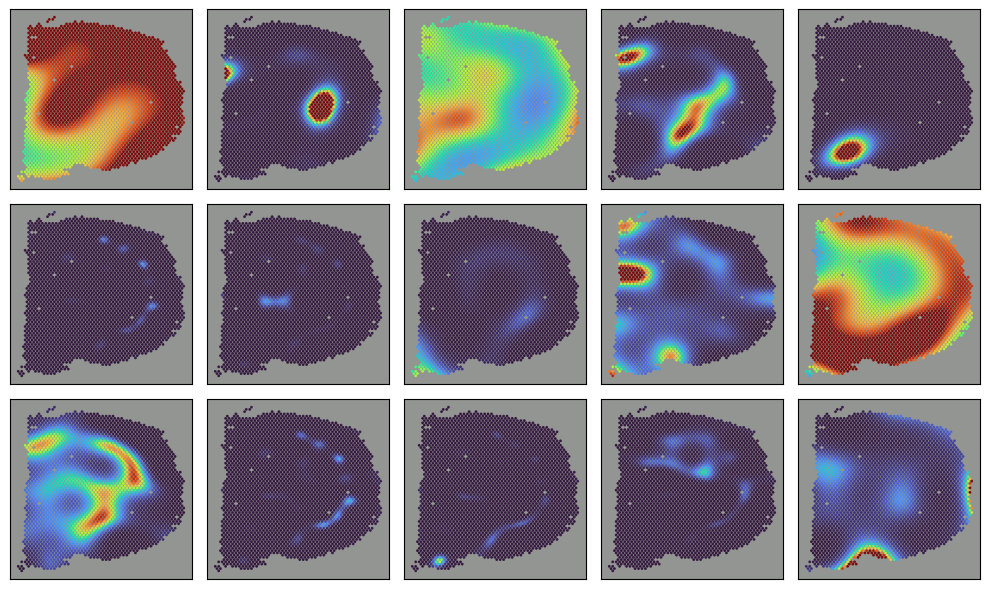

In [18]:
qF, _, _ = NSFH.sf.prior(X, kwargs=dicts)
means = torch.exp(qF.mean).detach().numpy() # means = factors
size=2    
moran_idx, moranI = putil.dims_autocorr(factors, X_train)
putil.plot_factors(means, X, moran_idx=moran_idx, size=2, s=1.0, alpha=0.9, ax=axes1)

In [25]:
file_path = f"validation_experiments/SVGP_M=2553_L=15_lr=0.001_jtr=0.1_ls=1.0_sigma=1.0_bs=128_NMFinit_model.pt"
dict_path = path.join(save_path, file_path)

In [28]:
dict = torch.load(dict_path)

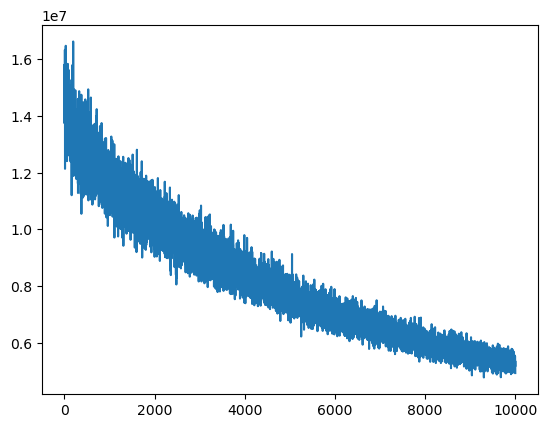

In [29]:
plt.plot(dict['losses'])